# Assignment: Practical 2
George Lu

## Abstract
RCMs, or Regional Climate Models, are a set of mathematical equations used to represent physical processes that govern the behavior of the climate in a particular area. It can range from different scales in space and time, and be used to better understand the dynamics of the regional climate of a specific area in the past, present, or future. In this practical, we looked at data outputted from the Regional Atmospheric Climate model (RACMO) applied at a 27km resolution across Antarctica. The specific output we look at are the daily temperatures and surface mass balance across Antarctica ranging from Jan 02, 1990 to Jan 01, 2000. Broadly, we have learned to spatially and temporally manipulate this dataset to return time- or space-specific data. We have learned how to compare data from different points in space, and also qualitatively compare trends across different data variables.

## Part 0: Setting up environment/explore data structure

In [1]:
import numpy as np
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

Have `P2_RACMO.npz` in the directory

In [2]:
ds = np.load('P2_RACMO.npz')

In [3]:
ds.files

['SMB', 'time', 'X', 'Y', 'T']

In [4]:
ds['SMB'].shape

(178, 207, 3652)

In [5]:
ds['time'].shape

(3652,)

In [6]:
ds['X'].shape

(207,)

In [7]:
ds['Y'].shape

(178,)

In [8]:
ds['T'].shape

(178, 207, 3652)

We see that T and SMB are dependent on X, Y, and time. Let's convert this into an xarray. I choose to use Xarray because I want to conduct a refresher of its capabilities, plus I am comfortable and used to using the array lookup and indexing methods associated with numpy arrays. 

In [9]:
data_vars = {'SMB':(['Y','X','time'], ds['SMB']*60*60*24*365/918, 
                         {'units': 'm/a', 
                          'long_name':'Surface mass balance'}),
            'T':(['Y','X','time'], ds['T'], 
                         {'units': 'K', 
                          'long_name':'2-m temperature'})}
coords = {'time':(['time'],ds['time'],{'units': 'days','long_name':'Date'}),
         'X': (['X'],ds['X'],{'units': 'm','long_name':'Polar stereographic coordinate'}),
         'Y': (['Y'],ds['Y'],{'units': 'm','long_name':'Orthogonal polar stereographic coordinate'})}

ds_xr = xr.Dataset(data_vars=data_vars, coords=coords)

In [10]:
ds_xr

<xarray.Dataset>
Dimensions:  (Y: 178, X: 207, time: 3652)
Coordinates:
  * time     (time) datetime64[ns] 1990-01-02 1990-01-03 ... 2000-01-01
  * X        (X) float64 -2.7e+06 -2.673e+06 -2.646e+06 ... 2.835e+06 2.862e+06
  * Y        (Y) float64 -2.254e+06 -2.227e+06 -2.2e+06 ... 2.498e+06 2.525e+06
Data variables:
    SMB      (Y, X, time) float64 0.0009256 0.0007402 ... 0.0001941 0.0002063
    T        (Y, X, time) float64 276.8 276.6 277.9 275.9 ... 273.8 273.9 274.2

## Part 1:
Extract the 2-m temperature on day 1 of the model output at the site of the West Antarctic Ice Sheet Divide Core (WDC)X = -1063200, Y = -431430, Polar stereographic coordinates. What date does this correspond to?

In [11]:
# Interpreting day 1 as the first point in time (i.e. index 0). 
# Interpolating to exact coords
temp = ds_xr.T.isel(time=0).interp(X=-1063200,Y=-431430).data
print(f'The temperature at X=-1063200 m ,Y=-431430 m  is {temp} K on day 1.')
print(f'The date is {ds_xr.time.isel(time=0).data}')

The temperature at X=-1063200 m ,Y=-431430 m  is 261.90743722849675 K on day 1.
The date is 1990-01-02T00:00:00.000000000


## Part 2:
Plot a time series of 2-m temperature at the WDC. 

Text(0.5, 1.0, '2-m temperature at the WDC')

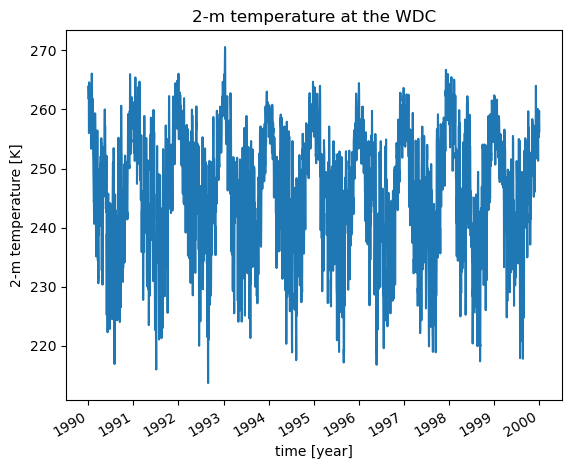

In [12]:
WDC = ds_xr.T.interp(X=-1063200,Y=-431430)
WDC.plot()
plt.xlabel('time [year]')
plt.title('2-m temperature at the WDC')

## Part 3:
How does 2-m temperature at WDC compare to 2-m temperature at the South Pole Ice Core? (Make a scatter plot)

Text(0.5, 1.0, 'Temperatures at WDC compared to same day at South Pole')

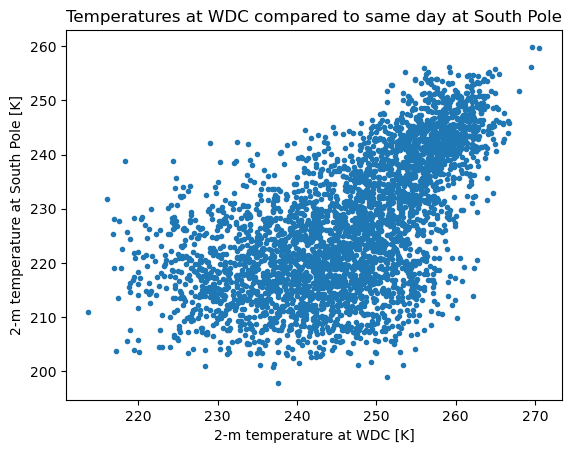

In [13]:
south_pole = ds_xr.T.interp(X=0,Y=0)
plt.plot(WDC.data,south_pole.data,'.')

plt.xlabel('2-m temperature at WDC [K]')
plt.ylabel('2-m temperature at South Pole [K]')
plt.title('Temperatures at WDC compared to same day at South Pole')


We can see that the South pole site is quite colder. Looking at the difference (plot below), we can see that the winters are roughly 40-50 K colder whereas the summers are roughly 0-10 K colder. 

Text(0, 0.5, 'temperature difference [K]')

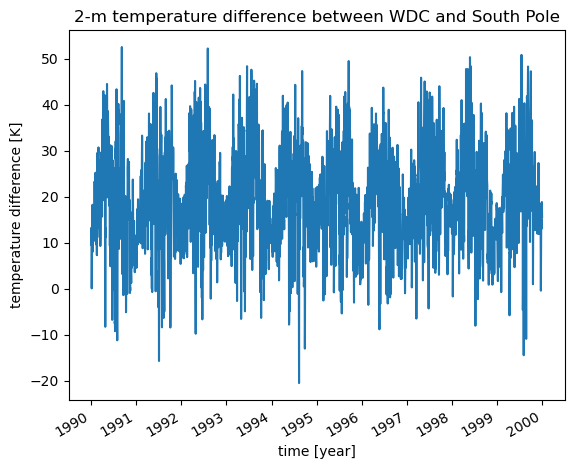

In [14]:
(WDC-south_pole).plot()
plt.xlabel('time [year]')
plt.title('2-m temperature difference between WDC and South Pole')
plt.ylabel('temperature difference [K]')

## Part 4:
Plot on the same axis (different colors) time series from all the locations 
contained in the file StationLocations.xls. I choose to use pandas as it is a standard for working with csv files in python.

In [15]:
# Load stations
stations= pd.read_csv('StationLocations.csv')

In [16]:
stations

,Station name,X,Y
0,Arrival Heights Satellite Station,306161.21740,-1291292.802
1,Scott Base,303279.04700,-1289815.972
2,Vanda,428258.56920,-1292411.640
3,Norway,-93283.84919,2136551.411
4,Tor,178387.46370,1975601.770
5,Troll,87139.03005,1968113.795
6,Maudheim,-393972.18370,2039477.890
7,South Pole,0.00000,0.000


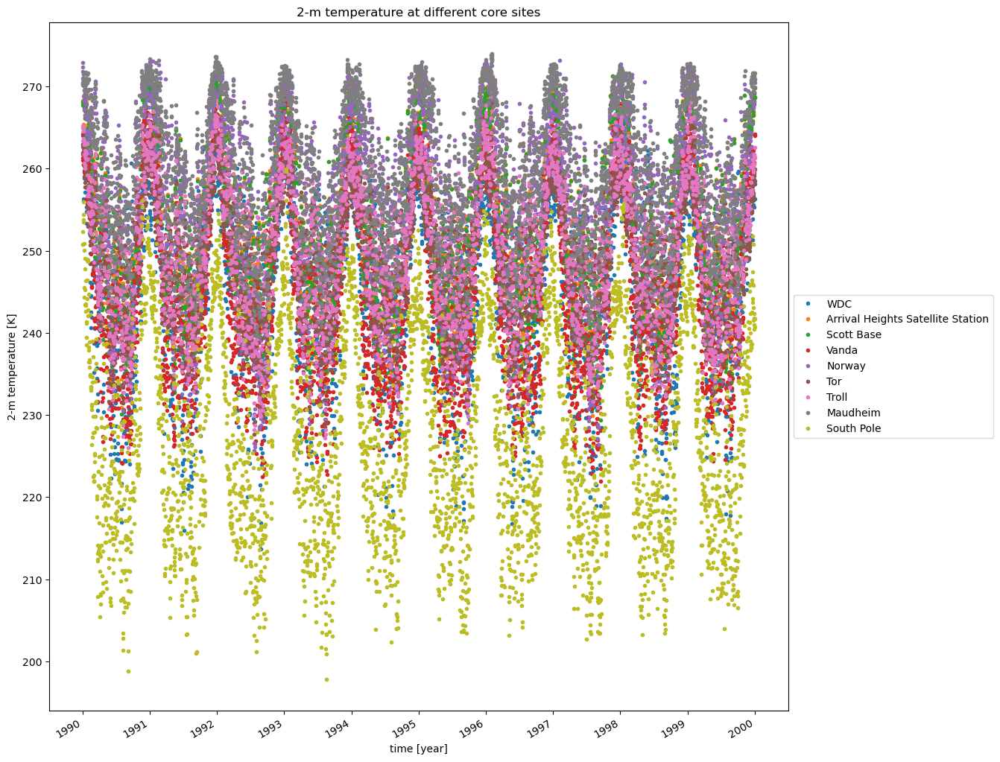

In [17]:
# Start with WDC
fig = plt.figure(figsize=(16,12))
ax = plt.subplot(1,1,1)
WDC.plot(ax=ax,marker='.',linestyle="None",label='WDC')

# Now loop through stations
for i in range(len(stations)):
    temp = ds_xr.T.interp(X=stations['X'][i],Y=stations['Y'][i])
    temp.plot(ax=ax,marker='.',linestyle="None",label = stations['Station name'][i])

plt.xlabel('time [year]')
plt.title('2-m temperature at different core sites')
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

## Part 5
Plot a map of surface mass balance on 18th May 1991 of the model output (what happened on this date?).

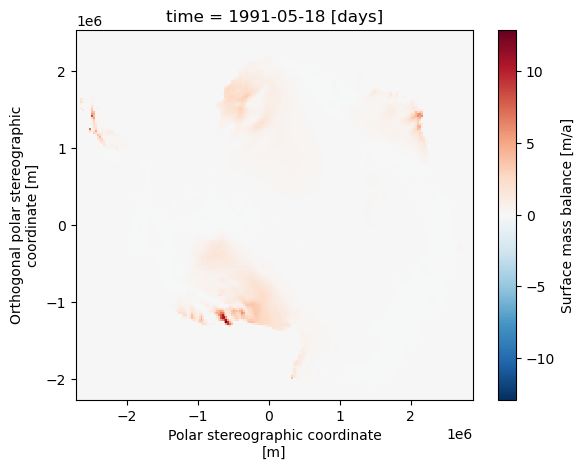

In [18]:
ds_xr.SMB.sel(time=pd.to_datetime('1991-05-18')).plot()

The SMB was entirely positive on this date, meaning that there was more snow than melt across the entire ice sheet.

## Part 6:
Plot side-by-side maps of the mean surface temperature and the mean SMB as functions of space.

Text(0.5, 1.0, 'Mean Temperature')

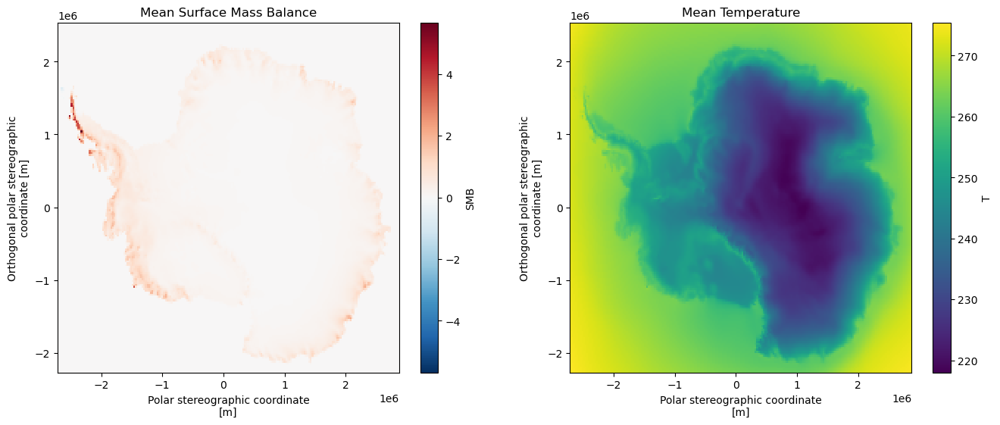

In [19]:
fig,ax = plt.subplots(ncols=2,figsize=(16,6))
ds_xr.SMB.mean(dim='time').plot(ax=ax[0])
ax[0].set_title('Mean Surface Mass Balance')

ds_xr.T.mean(dim='time').plot(ax=ax[1])
ax[1].set_title('Mean Temperature')


## Part 7:
Does mean SMB correlate with mean 2-m temperature?

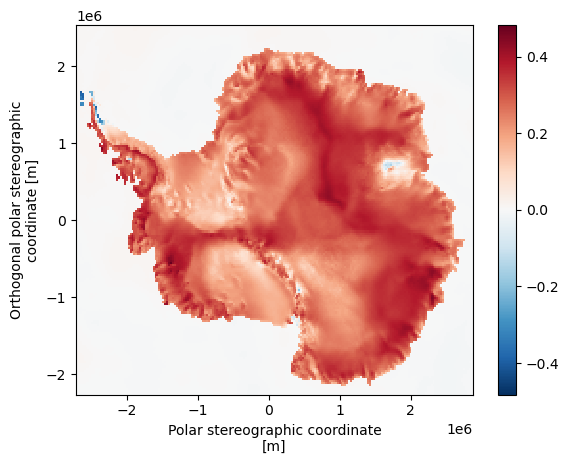

In [20]:
xr.corr(ds_xr.SMB,ds_xr.T,dim='time').plot()

There is a loose temporal correlation between SMB and temperature over space. We know this because there is a positive correlation coefficient across the majority of the space, but it is generally in the range of 0.3-0.4, which is not strong. So although higher temperatures likely result in higher SMB, the amount by which it is higher is not consistent.

## Part 8:
Create a gif animation of air temperature as it varies with time. 

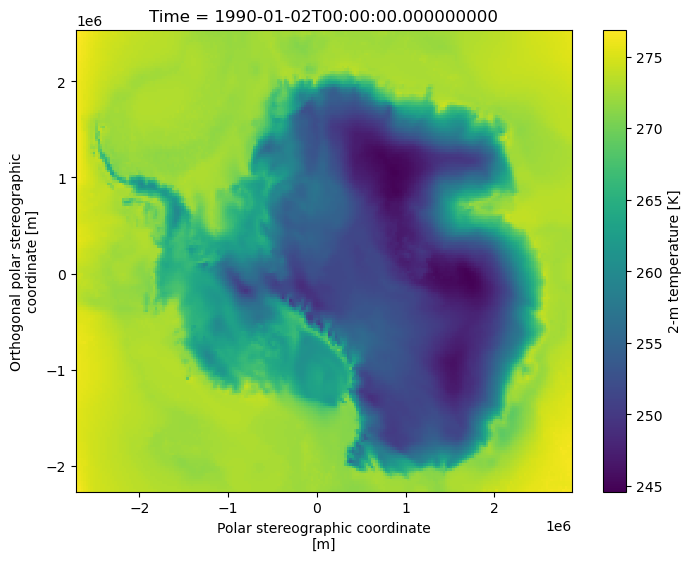

In [21]:
# This cell sets up the animation, the next cell animates it
from matplotlib import animation
fig, ax = plt.subplots(figsize=(8,6))

to_plot = ds_xr.T.isel(time=0).plot()

def animate(i):

    to_plot.set_array(ds_xr.T.isel(time = i*10))
    ax.set_title("Time = " + str(ds_xr.time.values[i*10]))
anim = animation.FuncAnimation(fig, animate, frames=ds_xr.time.size//10, repeat=True)


In [22]:
from IPython.display import HTML, display

HTML(anim.to_jshtml())


Animation size has reached 21083754 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
